# 1. Necessary Imports

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
#import ydata_profiling
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, f1_score, precision_score, recall_score
from sklearn.linear_model import LogisticRegression
#from ydata_profiling import ProfileReport

# 2. Dataset Summary

In [2]:
df = pd.read_csv('data/smoking.csv')

In [3]:
pd.set_option('display.max_columns', 1000)
pd.set_option('display.width', 1000)
df.head(10)

,ID,gender,age,height(cm),weight(kg),waist(cm),eyesight(left),eyesight(right),hearing(left),hearing(right),systolic,relaxation,fasting blood sugar,Cholesterol,triglyceride,HDL,LDL,hemoglobin,Urine protein,serum creatinine,AST,ALT,Gtp,oral,dental caries,tartar,smoking
0,0,F,40,155,60,81.3,1.2,1.0,1.0,1.0,114.0,73.0,94.0,215.0,82.0,73.0,126.0,12.9,1.0,0.7,18.0,19.0,27.0,Y,0,Y,0
1,1,F,40,160,60,81.0,0.8,0.6,1.0,1.0,119.0,70.0,130.0,192.0,115.0,42.0,127.0,12.7,1.0,0.6,22.0,19.0,18.0,Y,0,Y,0
2,2,M,55,170,60,80.0,0.8,0.8,1.0,1.0,138.0,86.0,89.0,242.0,182.0,55.0,151.0,15.8,1.0,1.0,21.0,16.0,22.0,Y,0,N,1
3,3,M,40,165,70,88.0,1.5,1.5,1.0,1.0,100.0,60.0,96.0,322.0,254.0,45.0,226.0,14.7,1.0,1.0,19.0,26.0,18.0,Y,0,Y,0
4,4,F,40,155,60,86.0,1.0,1.0,1.0,1.0,120.0,74.0,80.0,184.0,74.0,62.0,107.0,12.5,1.0,0.6,16.0,14.0,22.0,Y,0,N,0
5,5,M,30,180,75,85.0,1.2,1.2,1.0,1.0,128.0,76.0,95.0,217.0,199.0,48.0,129.0,16.2,1.0,1.2,18.0,27.0,33.0,Y,0,Y,0
6,6,M,40,160,60,85.5,1.0,1.0,1.0,1.0,116.0,82.0,94.0,226.0,68.0,55.0,157.0,17.0,1.0,0.7,21.0,27.0,39.0,Y,1,Y,1
7,7,M,45,165,90,96.0,1.2,1.0,1.0,1.0,153.0,96.0,158.0,222.0,269.0,34.0,134.0,15.0,1.0,1.3,38.0,71.0,111.0,Y,0,Y,0
8,9,F,50,150,60,85.0,0.7,0.8,1.0,1.0,115.0,74.0,86.0,210.0,66.0,48.0,149.0,13.7,1.0,0.8,31.0,31.0,14.0,Y,0,N,0
9,10,M,45,175,75,89.0,1.0,1.0,1.0,1.0,113.0,64.0,94.0,198.0,147.0,43.0,126.0,16.0,1.0,0.8,26.0,24.0,63.0,Y,0,N,0


In [3]:
df.head()

,ID,gender,age,height(cm),weight(kg),waist(cm),eyesight(left),eyesight(right),hearing(left),hearing(right),...,hemoglobin,Urine protein,serum creatinine,AST,ALT,Gtp,oral,dental caries,tartar,smoking
0,0,F,40,155,60,81.3,1.2,1.0,1.0,1.0,...,12.9,1.0,0.7,18.0,19.0,27.0,Y,0,Y,0
1,1,F,40,160,60,81.0,0.8,0.6,1.0,1.0,...,12.7,1.0,0.6,22.0,19.0,18.0,Y,0,Y,0
2,2,M,55,170,60,80.0,0.8,0.8,1.0,1.0,...,15.8,1.0,1.0,21.0,16.0,22.0,Y,0,N,1
3,3,M,40,165,70,88.0,1.5,1.5,1.0,1.0,...,14.7,1.0,1.0,19.0,26.0,18.0,Y,0,Y,0
4,4,F,40,155,60,86.0,1.0,1.0,1.0,1.0,...,12.5,1.0,0.6,16.0,14.0,22.0,Y,0,N,0


In [6]:
df.shape

(55692, 27)

In [193]:
df.describe(include='all')

,ID,gender,age,height(cm),weight(kg),waist(cm),eyesight(left),eyesight(right),hearing(left),hearing(right),...,hemoglobin,Urine protein,serum creatinine,AST,ALT,Gtp,oral,dental caries,tartar,smoking
count,55692.000000,55692,55692.000000,55692.000000,55692.000000,55692.000000,55692.000000,55692.000000,55692.000000,55692.000000,...,55692.000000,55692.000000,55692.000000,55692.000000,55692.000000,55692.000000,55692,55692.000000,55692,55692.000000
unique,NaN,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,1,NaN,2,NaN
top,NaN,M,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,Y,NaN,Y,NaN
freq,NaN,35401,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,55692,NaN,30940,NaN
mean,27845.500000,NaN,44.182917,164.649321,65.864936,82.046418,1.012623,1.007443,1.025587,1.026144,...,14.622592,1.087212,0.885738,26.182935,27.036037,39.952201,NaN,0.213334,NaN,0.367288
std,16077.039933,NaN,12.071418,9.194597,12.820306,9.274223,0.486873,0.485964,0.157902,0.159564,...,1.564498,0.404882,0.221524,19.355460,30.947853,50.290539,NaN,0.409665,NaN,0.482070
min,0.000000,NaN,20.000000,130.000000,30.000000,51.000000,0.100000,0.100000,1.000000,1.000000,...,4.900000,1.000000,0.100000,6.000000,1.000000,1.000000,NaN,0.000000,NaN,0.000000
25%,13922.750000,NaN,40.000000,160.000000,55.000000,76.000000,0.800000,0.800000,1.000000,1.000000,...,13.600000,1.000000,0.800000,19.000000,15.000000,17.000000,NaN,0.000000,NaN,0.000000
50%,27845.500000,NaN,40.000000,165.000000,65.000000,82.000000,1.000000,1.000000,1.000000,1.000000,...,14.800000,1.000000,0.900000,23.000000,21.000000,25.000000,NaN,0.000000,NaN,0.000000
75%,41768.250000,NaN,55.000000,170.000000,75.000000,88.000000,1.200000,1.200000,1.000000,1.000000,...,15.800000,1.000000,1.000000,28.000000,31.000000,43.000000,NaN,0.000000,NaN,1.000000


In [18]:
pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 40)
pd.set_option('max_info_columns', 40)
df.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 55692 entries, 0 to 55691
Data columns (total 27 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID                   55692 non-null  int64  
 1   gender               55692 non-null  object 
 2   age                  55692 non-null  int64  
 3   height(cm)           55692 non-null  int64  
 4   weight(kg)           55692 non-null  int64  
 5   waist(cm)            55692 non-null  float64
 6   eyesight(left)       55692 non-null  float64
 7   eyesight(right)      55692 non-null  float64
 8   hearing(left)        55692 non-null  float64
 9   hearing(right)       55692 non-null  float64
 10  systolic             55692 non-null  float64
 11  relaxation           55692 non-null  float64
 12  fasting blood sugar  55692 non-null  float64
 13  Cholesterol          55692 non-null  float64
 14  triglyceride         55692 non-null  float64
 15  HDL                  55692 non-null 

In [21]:
#pd.set_option('display.max_info_columns', 128)
pd.set_option('display.max_info_columns', len(df.columns))
df.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 55692 entries, 0 to 55691
Data columns (total 27 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID                   55692 non-null  int64  
 1   gender               55692 non-null  object 
 2   age                  55692 non-null  int64  
 3   height(cm)           55692 non-null  int64  
 4   weight(kg)           55692 non-null  int64  
 5   waist(cm)            55692 non-null  float64
 6   eyesight(left)       55692 non-null  float64
 7   eyesight(right)      55692 non-null  float64
 8   hearing(left)        55692 non-null  float64
 9   hearing(right)       55692 non-null  float64
 10  systolic             55692 non-null  float64
 11  relaxation           55692 non-null  float64
 12  fasting blood sugar  55692 non-null  float64
 13  Cholesterol          55692 non-null  float64
 14  triglyceride         55692 non-null  float64
 15  HDL                  55692 non-null 

In [22]:
numerical_features = df.select_dtypes(include=['int', 'float']).columns
print("Numerical Features:")
print(numerical_features)
print("Count:")
print(len(numerical_features))

Numerical Features:
Index(['ID', 'age', 'height(cm)', 'weight(kg)', 'waist(cm)', 'eyesight(left)', 'eyesight(right)', 'hearing(left)', 'hearing(right)', 'systolic', 'relaxation', 'fasting blood sugar', 'Cholesterol', 'triglyceride', 'HDL', 'LDL', 'hemoglobin', 'Urine protein', 'serum creatinine', 'AST', 'ALT', 'Gtp', 'dental caries', 'smoking'], dtype='object')
Count:
24


In [24]:
categorical_features = df.select_dtypes(include=['object']).columns
print("Categorical Features:")
print(categorical_features)
print("Count:")
print(len(categorical_features))

Categorical Features:
Index(['gender', 'oral', 'tartar'], dtype='object')
Count:
3


In [25]:
discrete_features = [col for col, unique_count in df[numerical_features].nunique().items() if unique_count < 25]
continuous_features = [col for col in numerical_features if col not in discrete_features]
print("Discrete Features:", discrete_features)
print("Count:")
print(len(discrete_features))
print("Continuous Features:", continuous_features)
print("Count:")
print(len(continuous_features))

Discrete Features: ['age', 'height(cm)', 'weight(kg)', 'eyesight(left)', 'eyesight(right)', 'hearing(left)', 'hearing(right)', 'Urine protein', 'dental caries', 'smoking']
Count:
10
Continuous Features: ['ID', 'waist(cm)', 'systolic', 'relaxation', 'fasting blood sugar', 'Cholesterol', 'triglyceride', 'HDL', 'LDL', 'hemoglobin', 'serum creatinine', 'AST', 'ALT', 'Gtp']
Count:
14


In [26]:
# Unique values of cathegorical columns
print("Unique values for Oral column:", df["oral"].unique())
print("Unique values for Gender column:", df["gender"].unique())
print("Unique values for Tartar column:", df["tartar"].unique())

Unique values for Oral column: ['Y']
Unique values for Gender column: ['F' 'M']
Unique values for Tartar column: ['Y' 'N']


In [198]:
# Automated EDA report
description = ProfileReport(df, title='Pandas Profiling Report', explorative=True)
description

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# 3. Dataset Cleaning

In [27]:
df.head(5)

,ID,gender,age,height(cm),weight(kg),waist(cm),eyesight(left),eyesight(right),hearing(left),hearing(right),systolic,relaxation,fasting blood sugar,Cholesterol,triglyceride,HDL,LDL,hemoglobin,Urine protein,serum creatinine,AST,ALT,Gtp,oral,dental caries,tartar,smoking
0,0,F,40,155,60,81.3,1.2,1.0,1.0,1.0,114.0,73.0,94.0,215.0,82.0,73.0,126.0,12.9,1.0,0.7,18.0,19.0,27.0,Y,0,Y,0
1,1,F,40,160,60,81.0,0.8,0.6,1.0,1.0,119.0,70.0,130.0,192.0,115.0,42.0,127.0,12.7,1.0,0.6,22.0,19.0,18.0,Y,0,Y,0
2,2,M,55,170,60,80.0,0.8,0.8,1.0,1.0,138.0,86.0,89.0,242.0,182.0,55.0,151.0,15.8,1.0,1.0,21.0,16.0,22.0,Y,0,N,1
3,3,M,40,165,70,88.0,1.5,1.5,1.0,1.0,100.0,60.0,96.0,322.0,254.0,45.0,226.0,14.7,1.0,1.0,19.0,26.0,18.0,Y,0,Y,0
4,4,F,40,155,60,86.0,1.0,1.0,1.0,1.0,120.0,74.0,80.0,184.0,74.0,62.0,107.0,12.5,1.0,0.6,16.0,14.0,22.0,Y,0,N,0


In [5]:
# Removing ID column due to its redundancy
df.reset_index(drop=True, inplace=True)
df.head()

,ID,gender,age,height(cm),weight(kg),waist(cm),eyesight(left),eyesight(right),hearing(left),hearing(right),systolic,relaxation,fasting blood sugar,Cholesterol,triglyceride,HDL,LDL,hemoglobin,Urine protein,serum creatinine,AST,ALT,Gtp,oral,dental caries,tartar,smoking
0,0,F,40,155,60,81.3,1.2,1.0,1.0,1.0,114.0,73.0,94.0,215.0,82.0,73.0,126.0,12.9,1.0,0.7,18.0,19.0,27.0,Y,0,Y,0
1,1,F,40,160,60,81.0,0.8,0.6,1.0,1.0,119.0,70.0,130.0,192.0,115.0,42.0,127.0,12.7,1.0,0.6,22.0,19.0,18.0,Y,0,Y,0
2,2,M,55,170,60,80.0,0.8,0.8,1.0,1.0,138.0,86.0,89.0,242.0,182.0,55.0,151.0,15.8,1.0,1.0,21.0,16.0,22.0,Y,0,N,1
3,3,M,40,165,70,88.0,1.5,1.5,1.0,1.0,100.0,60.0,96.0,322.0,254.0,45.0,226.0,14.7,1.0,1.0,19.0,26.0,18.0,Y,0,Y,0
4,4,F,40,155,60,86.0,1.0,1.0,1.0,1.0,120.0,74.0,80.0,184.0,74.0,62.0,107.0,12.5,1.0,0.6,16.0,14.0,22.0,Y,0,N,0


In [200]:
df.duplicated() # checking if a given row is a duplicate of a previous one

0        False
1        False
2        False
3        False
4        False
         ...  
55687    False
55688    False
55689    False
55690    False
55691    False
Length: 55692, dtype: bool

In [29]:
df.duplicated().sum() # identifying the amount of duplicated rows

0

In [202]:
# Identifying missing values

In [30]:
df.isnull().sum().sort_values(ascending=False) # identifying the amount of NaN in each column

ID                     0
triglyceride           0
tartar                 0
dental caries          0
oral                   0
Gtp                    0
ALT                    0
AST                    0
serum creatinine       0
Urine protein          0
hemoglobin             0
LDL                    0
HDL                    0
Cholesterol            0
gender                 0
fasting blood sugar    0
relaxation             0
systolic               0
hearing(right)         0
hearing(left)          0
eyesight(right)        0
eyesight(left)         0
waist(cm)              0
weight(kg)             0
height(cm)             0
age                    0
smoking                0
dtype: int64

In [204]:
from scipy import stats

# setting the threshold
# 3 - conservative approach, good coverage of data distribution
threshold = 3

# creating an empty DataFrame to store the outliers
outliers_df = pd.DataFrame()

# looping through each numerical feature of the dataset
for feature in numerical_features:

    # computing the z-scores for the current feature
    z_scores = stats.zscore(df[feature])

    # identifying outliers based on the threshold
    feature_outliers = df[abs(z_scores) > threshold]

    # adding the outliers for the current feature to the outliers DataFrame
    outliers_df = pd.concat([outliers_df, feature_outliers])

# removing duplicate rows from the outliers DataFrame
outliers_df = outliers_df.drop_duplicates()

print("Outliers:")
print(outliers_df)


Outliers:
          ID gender  age  height(cm)  weight(kg)  waist(cm)  eyesight(left)  \
2599    3267      F   85         145          50       78.0             0.6   
4342    5470      M   85         160          65       92.9             0.7   
5246    6612      M   85         165          70       90.0             0.6   
11310  14152      M   85         155          45       72.0             0.5   
15959  19901      M   85         165          70       95.0             0.1   
...      ...    ...  ...         ...         ...        ...             ...   
55146  52926      F   45         150          45       71.0             0.5   
55158  52987      M   50         175          90       99.0             1.2   
55303  53738      M   60         160          65       82.0             0.7   
55367  54024      M   60         160          70       94.0             1.0   
55533  54920      M   45         170          70       81.4             1.0   

       eyesight(right)  hearing(left)  he

# 4. Data Visualisation

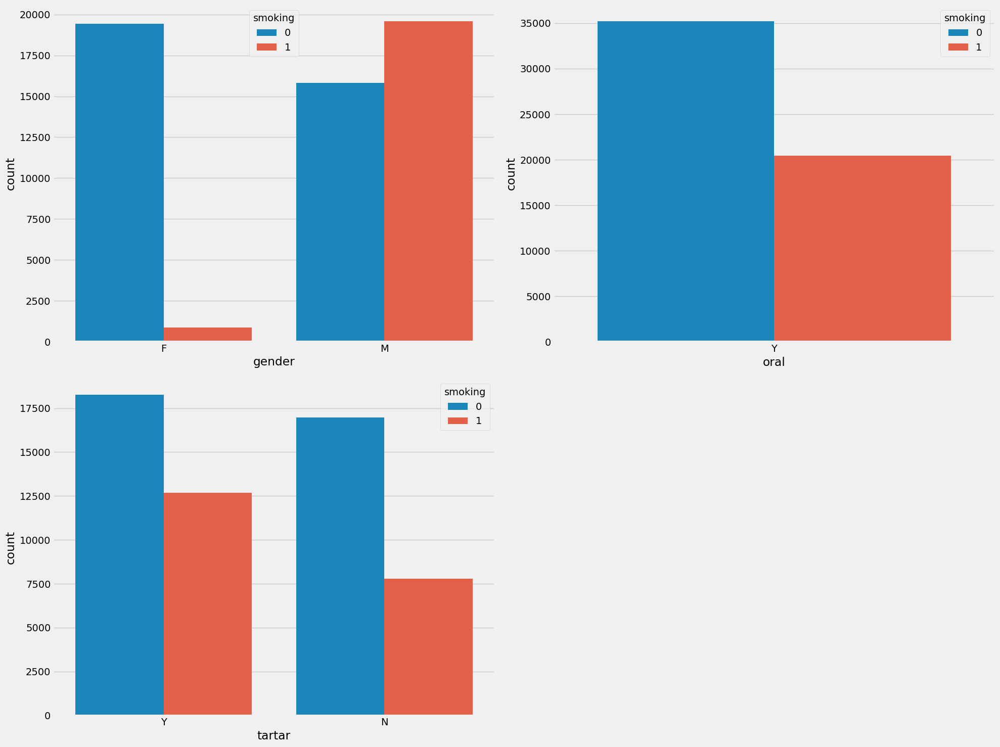

In [205]:
# Cathegorical variables

import matplotlib.pyplot as plt
import seaborn as sns

#plt.style.use("seaborn")
plt.figure(figsize=(20, 15))
a = 0
for var in categorical_features:
    a += 1
    plt.subplot(2, 2, a)
    sns.countplot(data=df, x=var, hue="smoking")
plt.tight_layout()
plt.show()


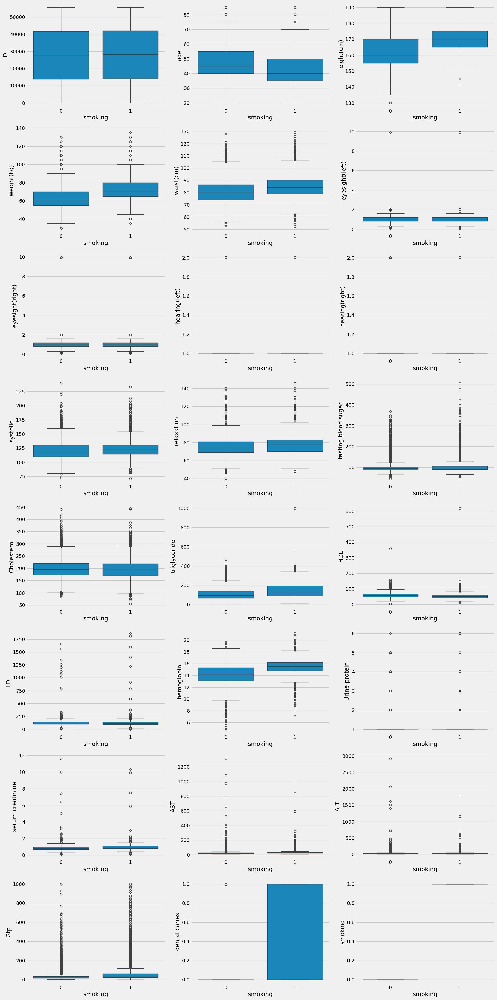

In [206]:
# Numerical Variables

num_features = len(numerical_features)
num_cols = 3  # Set the number of columns for subplots
num_rows = (num_features + num_cols - 1) // num_cols

plt.figure(figsize=(20, 5*num_rows))
a = 0

for i, var in enumerate(numerical_features[:num_rows * num_cols]):
    plt.subplot(num_rows, num_cols, i + 1)
    sns.boxplot(data=df, x="smoking", y=var)

plt.tight_layout()
plt.show()


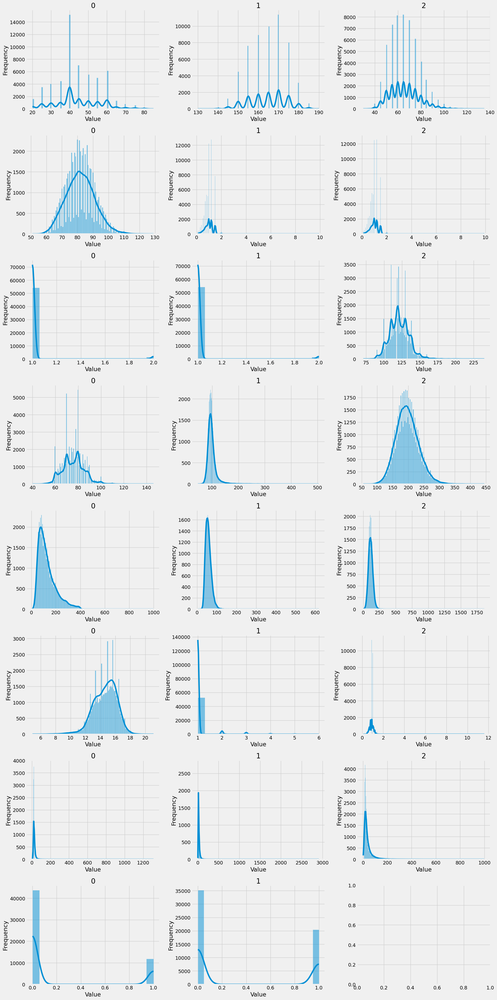

In [207]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

numerical_features = [col for col in df.columns if col != "ID" and df[col].dtype in ['float64', 'int64']]

num_rows = (len(numerical_features) + 2) // 3  # Add 2 to round up to the nearest whole number

fig, axes = plt.subplots(num_rows, 3, figsize=(20, num_rows*5))

if not isinstance(axes, np.ndarray):
    axes = np.array(axes)

for i, col in enumerate(numerical_features):
    row = i // 3
    col = i % 3
    sns.histplot(df[numerical_features[i]], ax=axes[row, col], kde=True)
    axes[row, col].set_title(col)
    axes[row, col].set_xlabel('Value')
    axes[row, col].set_ylabel('Frequency')


plt.tight_layout()
plt.show()


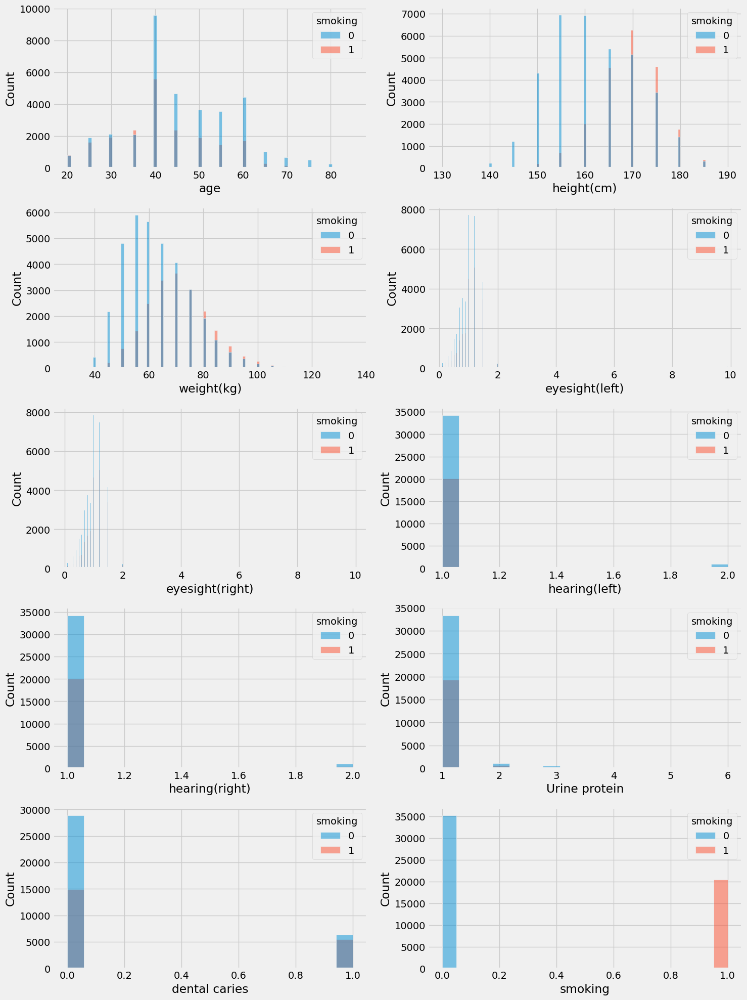

In [208]:
# Discrete Features - Histograms

plt.figure(figsize=(15,20))

a=0

for var in discrete_features:
    a=a+1
    plt.subplot(5,2,a)
    sns.histplot(data=df,x=var, hue="smoking",)

plt.tight_layout()
plt.show()

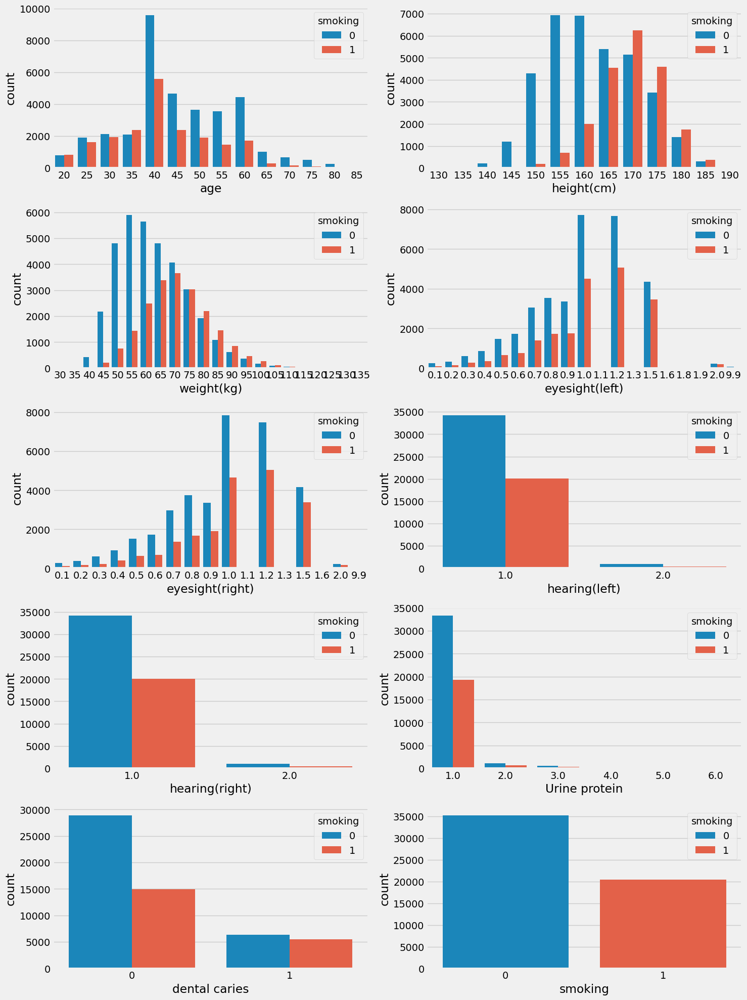

In [209]:
# Discrete Features - Countplots

plt.figure(figsize=(15,20))
a=0

for var in discrete_features:
    a=a+1
    plt.subplot(5,2,a)
    sns.countplot(data=df,x=var, hue="smoking")

plt.tight_layout()
plt.show()

# Correlation Matrix

In [210]:
# Correlation Matrix
numeric_df = df.select_dtypes(include=['number'])
corr = numeric_df.corr()
corr.style.background_gradient(cmap='coolwarm').format("{:.2f}")


,ID,age,height(cm),weight(kg),waist(cm),eyesight(left),eyesight(right),hearing(left),hearing(right),systolic,relaxation,fasting blood sugar,Cholesterol,triglyceride,HDL,LDL,hemoglobin,Urine protein,serum creatinine,AST,ALT,Gtp,dental caries,smoking
ID,1.00,-0.00,0.01,0.00,0.01,0.01,0.00,0.00,-0.00,0.00,0.00,0.00,-0.00,0.00,-0.01,0.00,0.01,0.00,0.00,-0.00,-0.00,0.00,0.00,0.01
age,-0.00,1.00,-0.48,-0.32,-0.03,-0.20,-0.19,0.20,0.21,0.13,0.05,0.18,0.06,0.02,0.01,0.04,-0.26,0.03,-0.11,0.03,-0.06,0.01,-0.11,-0.16
height(cm),0.01,-0.48,1.00,0.68,0.38,0.15,0.16,-0.08,-0.08,0.08,0.11,0.02,-0.08,0.16,-0.21,-0.05,0.54,0.01,0.38,0.04,0.13,0.14,0.08,0.40
weight(kg),0.00,-0.32,0.68,1.00,0.82,0.11,0.11,-0.05,-0.05,0.27,0.27,0.14,0.03,0.32,-0.36,0.04,0.49,0.03,0.32,0.12,0.25,0.21,0.07,0.30
waist(cm),0.01,-0.03,0.38,0.82,1.00,0.03,0.04,0.02,0.02,0.32,0.29,0.21,0.07,0.36,-0.38,0.07,0.39,0.05,0.24,0.14,0.25,0.24,0.04,0.23
eyesight(left),0.01,-0.20,0.15,0.11,0.03,1.00,0.35,-0.05,-0.05,-0.02,0.01,-0.04,-0.00,0.02,-0.02,-0.01,0.10,-0.00,0.07,-0.01,0.02,0.00,0.00,0.06
eyesight(right),0.00,-0.19,0.16,0.11,0.04,0.35,1.00,-0.04,-0.05,-0.01,0.01,-0.04,-0.01,0.02,-0.02,-0.01,0.10,-0.01,0.05,-0.01,0.02,0.01,0.02,0.06
hearing(left),0.00,0.20,-0.08,-0.05,0.02,-0.05,-0.04,1.00,0.51,0.06,0.01,0.04,-0.02,0.00,-0.02,-0.02,-0.03,0.01,0.00,0.02,0.00,0.01,-0.02,-0.02
hearing(right),-0.00,0.21,-0.08,-0.05,0.02,-0.05,-0.05,0.51,1.00,0.05,0.00,0.04,-0.02,0.00,-0.02,-0.02,-0.03,0.02,0.01,0.01,-0.01,0.01,-0.02,-0.02
systolic,0.00,0.13,0.08,0.27,0.32,-0.02,-0.01,0.06,0.05,1.00,0.76,0.17,0.06,0.20,-0.09,0.02,0.19,0.05,0.07,0.08,0.09,0.17,0.03,0.07


# 5. Feature Engineering

# Label Encoding for Gender and Tartar features

In [4]:
df.gender.head(5)

0    F
1    F
2    M
3    M
4    F
Name: gender, dtype: object

In [6]:
df.tartar.head(5)

0    Y
1    Y
2    N
3    Y
4    N
Name: tartar, dtype: object

In [7]:
label_encoder = LabelEncoder()

# Encode gender column
df['gender'] = label_encoder.fit_transform(df['gender'])

# Encode tartat column
df['tartar'] = label_encoder.fit_transform(df['tartar'])

# Encode oral column
df['oral'] = label_encoder.fit_transform(df['oral'])

print(df[['gender', 'gender']].head())
print(df[['tartar', 'tartar']].head())
print(df[['gender', 'gender']].head())
print(df[['oral', 'oral']].head())

   gender  gender
0       0       0
1       0       0
2       1       1
3       1       1
4       0       0
   tartar  tartar
0       1       1
1       1       1
2       0       0
3       1       1
4       0       0
   gender  gender
0       0       0
1       0       0
2       1       1
3       1       1
4       0       0
   oral  oral
0     0     0
1     0     0
2     0     0
3     0     0
4     0     0


In [8]:
label_encoder

LabelEncoder()

In [18]:
import pickle
with open('m_work/models/label_pre.pkl', 'wb') as file:
    labeler = pickle.dump(label_encoder, file)

In [36]:
df.tartar.head(5) # make sure it worked

0    1
1    1
2    0
3    1
4    0
Name: tartar, dtype: int64

# Dataset Splitting

In [20]:

# Identifying dependent (target) variable
y = df["smoking"]

# Identifying independent variables
X = df.drop("smoking", axis = 1)

# Splitting
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

print("X_train shape:", X_train.shape)
print("X_test shape:", X_test.shape)
print("y_train shape:", y_train.shape)
print("y_test shape:", y_test.shape)


X_train shape: (44553, 26)
X_test shape: (11139, 26)
y_train shape: (44553,)
y_test shape: (11139,)


# Scalling

In [38]:
df.head(3)

,ID,gender,age,height(cm),weight(kg),waist(cm),eyesight(left),eyesight(right),hearing(left),hearing(right),systolic,relaxation,fasting blood sugar,Cholesterol,triglyceride,HDL,LDL,hemoglobin,Urine protein,serum creatinine,AST,ALT,Gtp,oral,dental caries,tartar,smoking
0,0,0,40,155,60,81.3,1.2,1.0,1.0,1.0,114.0,73.0,94.0,215.0,82.0,73.0,126.0,12.9,1.0,0.7,18.0,19.0,27.0,0,0,1,0
1,1,0,40,160,60,81.0,0.8,0.6,1.0,1.0,119.0,70.0,130.0,192.0,115.0,42.0,127.0,12.7,1.0,0.6,22.0,19.0,18.0,0,0,1,0
2,2,1,55,170,60,80.0,0.8,0.8,1.0,1.0,138.0,86.0,89.0,242.0,182.0,55.0,151.0,15.8,1.0,1.0,21.0,16.0,22.0,0,0,0,1


In [30]:
X_train_scaled.head(3) # proof of scaling, the actual scaling happens below

NameError: name 'X_train_scaled' is not defined

In [40]:
numerical_features = X_train.select_dtypes(include=['number']).columns
numerical_features.shape # 26 so basically all of them, no more objects non-numerical

(26,)

In [39]:
scaler = StandardScaler()

# Identify numerical features
numerical_features = X_train.select_dtypes(include=['number']).columns

# Fit the scaler on the training data and transform numerical features only
X_train_scaled = X_train.copy()
X_test_scaled = X_test.copy()

X_train_scaled[numerical_features] = scaler.fit_transform(X_train[numerical_features])
X_test_scaled[numerical_features] = scaler.transform(X_test[numerical_features])


In [53]:
pd.DataFrame(X_train_scaled.loc[0]).to_csv('sample_datapoint.csv')

In [40]:
import pickle
with open('m_work/models/scale_pre.pkl', 'wb') as file:
    pickle.dump(scaler, file)

In [28]:
# Majd here pipeline FAILLLLLLLLL
from sklearn.pipeline import Pipeline

smok_pipe = Pipeline([

    ('scal',StandardScaler()),
    ('randfor',RandomForestClassifier(random_state=42))

])

print(smok_pipe)

Pipeline(steps=[('scal', StandardScaler()),
                ('randfor', RandomForestClassifier(random_state=42))])


In [31]:
smok_pipe

Pipeline(steps=[('scal', StandardScaler()),
                ('randfor', RandomForestClassifier(random_state=42))])

In [33]:
smok_pipe.fit(X,y)

Pipeline(steps=[('scal', StandardScaler()),
                ('randfor', RandomForestClassifier(random_state=42))])

In [38]:
smok_pipe.predict(X.loc[0])

/home/roti/.pyenv/versions/3.10.6/envs/smoking/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


ValueError: Expected a 2-dimensional container but got <class 'pandas.core.series.Series'> instead. Pass a DataFrame containing a single row (i.e. single sample) or a single column (i.e. single feature) instead.

In [35]:
X.loc[0]

ID                       0.0
gender                   0.0
age                     40.0
height(cm)             155.0
weight(kg)              60.0
waist(cm)               81.3
eyesight(left)           1.2
eyesight(right)          1.0
hearing(left)            1.0
hearing(right)           1.0
systolic               114.0
relaxation              73.0
fasting blood sugar     94.0
Cholesterol            215.0
triglyceride            82.0
HDL                     73.0
LDL                    126.0
hemoglobin              12.9
Urine protein            1.0
serum creatinine         0.7
AST                     18.0
ALT                     19.0
Gtp                     27.0
oral                     0.0
dental caries            0.0
tartar                   1.0
Name: 0, dtype: float64

# 6. Modelling

# Logisitic Regression

In [214]:
log_reg = LogisticRegression(random_state=42)

log_reg.fit(X_train_scaled, y_train)

y_pred_log = log_reg.predict(X_test_scaled)

# Preformance metrics for Logistic Regression
log_accuracy = accuracy_score(y_test, y_pred)
log_f1 = f1_score(y_test, y_pred)
log_precision = precision_score(y_test, y_pred)

print("Accuracy:", log_accuracy)
print("F1 score:", log_f1)
print("Precision score:", log_precision)

Accuracy: 0.7409103151090762
F1 score: 0.6622191011235955
Precision score: 0.638312274368231


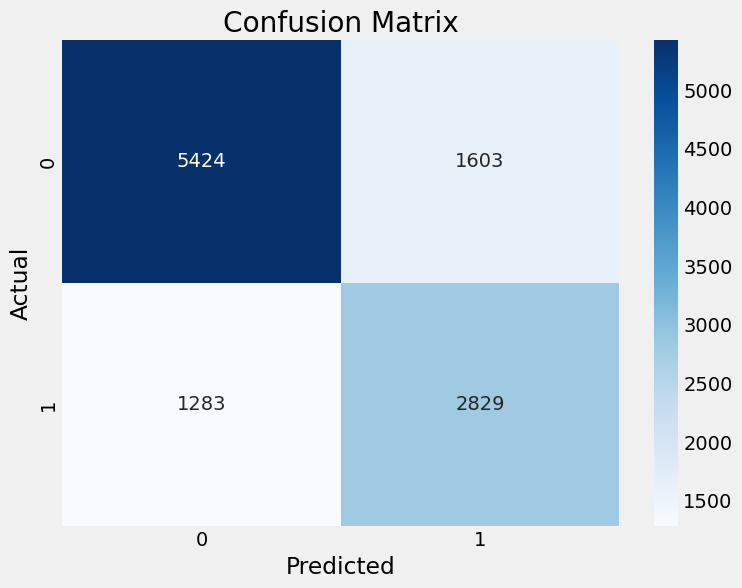

In [215]:
# Create confusion matrix
conf_matrix = confusion_matrix(y_test, y_pred)

# Plot confusion matrix heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

# Random Forest

In [41]:
rf_classifier

NameError: name 'rf_classifier' is not defined

In [42]:
rf_classifier = RandomForestClassifier(random_state=42)

rf_classifier.fit(X_train_scaled, y_train)

y_pred_rf = rf_classifier.predict(X_test_scaled)

In [43]:
import pickle
with open('m_work/models/model_pre.pkl', 'wb') as file:
    pickle.dump(rf_classifier, file)

In [100]:
rf_classifier.predict(np.reshape(X_test_scaled.iloc[2,:],(1,26)))

/home/roti/.pyenv/versions/3.10.6/envs/smoking/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


array([1])

In [ ]:
np.shape(X_test_scaled.iloc[2,:].values.flatten().tolist())

In [99]:
np.reshape(X_test_scaled.iloc[2,:].values.flatten().tolist(),(1,26))

array([[-0.53473706,  0.75687906, -1.58875855,  0.58097117,  1.10279412,
         1.28756221, -0.02577826,  0.39752596, -0.16190163, -0.16587296,
        -0.8373109 , -0.61790191,  5.17109148,  0.42090988,  3.08857589,
        -1.37091623, -0.24138188,  1.26573675, -0.21522819, -0.40119792,
         2.8135947 ,  3.64087258,  4.10153241,  0.        ,  1.92410072,
        -1.1175429 ]])

In [96]:
np.reshape(X_test_scaled.iloc[2,:],(1,26))

array([[-0.53473706,  0.75687906, -1.58875855,  0.58097117,  1.10279412,
         1.28756221, -0.02577826,  0.39752596, -0.16190163, -0.16587296,
        -0.8373109 , -0.61790191,  5.17109148,  0.42090988,  3.08857589,
        -1.37091623, -0.24138188,  1.26573675, -0.21522819, -0.40119792,
         2.8135947 ,  3.64087258,  4.10153241,  0.        ,  1.92410072,
        -1.1175429 ]])

In [44]:
rf_accuracy = accuracy_score(y_test, y_pred_rf)

rf_precision = precision_score(y_test, y_pred_rf)

rf_f1 = f1_score(y_test, y_pred_rf)

print("Accuracy:", rf_accuracy)
print("F1 score:", rf_f1)
print("Precision score:", rf_precision)

Accuracy: 0.8303258820360894
F1 score: 0.7746781115879828
Precision score: 0.759822263797942


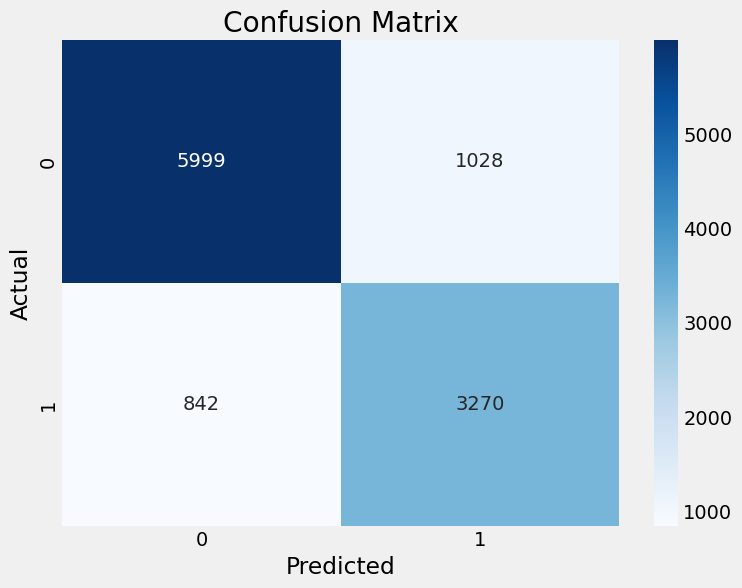

In [220]:
# Calculating confusion matrix for Random Forest Classifier
conf_matrix = confusion_matrix(y_test, y_pred_rf)

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

# Feature Importance

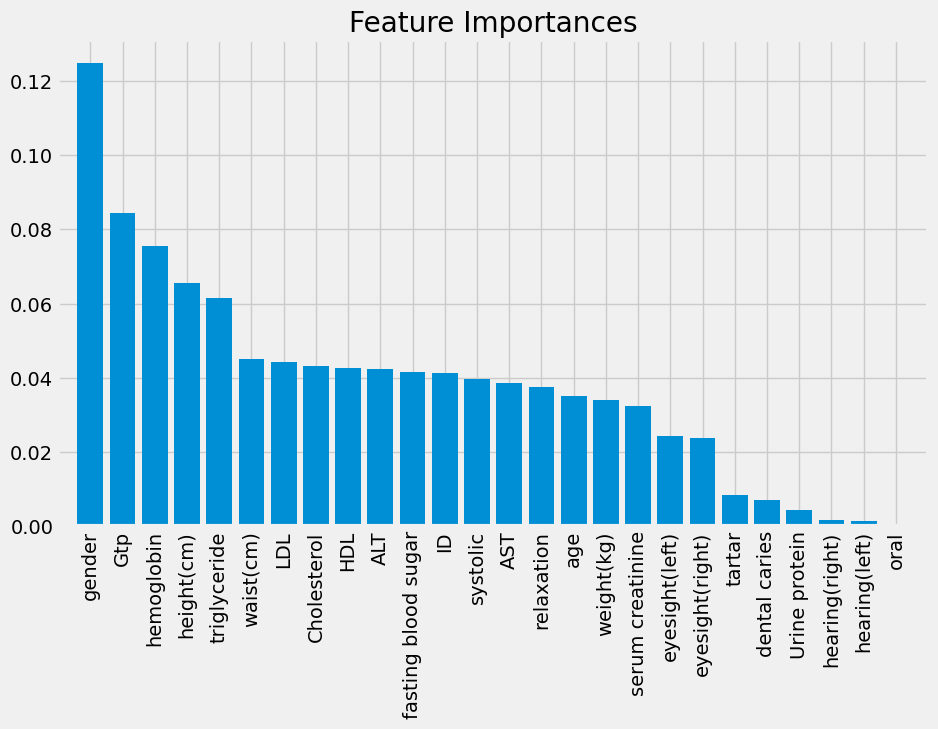

In [219]:
import matplotlib.pyplot as plt

importances = rf_classifier.feature_importances_

# Sorting feature importances in descending order
indices = np.argsort(importances)[::-1]

plt.figure(figsize=(10, 6))
plt.title("Feature Importances")
plt.bar(range(X_train.shape[1]), importances[indices], align="center")
plt.xticks(range(X_train.shape[1]), X_train.columns[indices], rotation=90)
plt.xlim([-1, X_train.shape[1]])
plt.show()


In [101]:
def floatingg(listt):
    abc = []
    for itemm in listt:
        abc.append(float(itemm))
    return abc

In [103]:
m = ["21","33"]

In [104]:
floatingg(m)

[21.0, 33.0]

In [108]:
df.columns

Index(['ID', 'gender', 'age', 'height(cm)', 'weight(kg)', 'waist(cm)', 'eyesight(left)', 'eyesight(right)', 'hearing(left)', 'hearing(right)', 'systolic', 'relaxation', 'fasting blood sugar', 'Cholesterol', 'triglyceride', 'HDL', 'LDL', 'hemoglobin', 'Urine protein', 'serum creatinine', 'AST', 'ALT', 'Gtp', 'oral', 'dental caries', 'tartar', 'smoking'], dtype='object')

In [114]:
xyz = pd.DataFrame([X_train.loc[1]],columns=['ID', 'gender', 'age', 'height(cm)', 'weight(kg)', 'waist(cm)', 'eyesight(left)', 'eyesight(right)', 'hearing(left)', 'hearing(right)', 'systolic', 'relaxation', 'fasting blood sugar', 'Cholesterol', 'triglyceride', 'HDL', 'LDL', 'hemoglobin', 'Urine protein', 'serum creatinine', 'AST', 'ALT', 'Gtp', 'oral', 'dental caries', 'tartar'])


In [115]:
xyz

,ID,gender,age,height(cm),weight(kg),waist(cm),eyesight(left),eyesight(right),hearing(left),hearing(right),systolic,relaxation,fasting blood sugar,Cholesterol,triglyceride,HDL,LDL,hemoglobin,Urine protein,serum creatinine,AST,ALT,Gtp,oral,dental caries,tartar
1,1.0,0.0,40.0,160.0,60.0,81.0,0.8,0.6,1.0,1.0,119.0,70.0,130.0,192.0,115.0,42.0,127.0,12.7,1.0,0.6,22.0,19.0,18.0,0.0,0.0,1.0


In [113]:
X_train.loc[1]

ID                       1.0
gender                   0.0
age                     40.0
height(cm)             160.0
weight(kg)              60.0
waist(cm)               81.0
eyesight(left)           0.8
eyesight(right)          0.6
hearing(left)            1.0
hearing(right)           1.0
systolic               119.0
relaxation              70.0
fasting blood sugar    130.0
Cholesterol            192.0
triglyceride           115.0
HDL                     42.0
LDL                    127.0
hemoglobin              12.7
Urine protein            1.0
serum creatinine         0.6
AST                     22.0
ALT                     19.0
Gtp                     18.0
oral                     0.0
dental caries            0.0
tartar                   1.0
Name: 1, dtype: float64

In [118]:
abc = [3,5,6,7]
abc.insert(1,"F")

In [119]:
abc

[3, 'F', 5, 6, 7]

In [ ]:
oh_encoder = OneHotEncoder(sparse=False, handle_unknown='ignore')
encoded_cols = oh_encoder.fit_transform(df[cat_cols])
df_enc = pd.DataFrame(encoded_cols, columns=cat_cols_encoded)
df_oh = df.join(df_enc)
df_oh

df['gender'] = label_encoder.fit_transform(df['gender'])

In [5]:
from sklearn.preprocessing import OneHotEncoder

In [7]:
df.head(1)

,ID,gender,age,height(cm),weight(kg),waist(cm),eyesight(left),eyesight(right),hearing(left),hearing(right),...,hemoglobin,Urine protein,serum creatinine,AST,ALT,Gtp,oral,dental caries,tartar,smoking
0,0,F,40,155,60,81.3,1.2,1.0,1.0,1.0,...,12.9,1.0,0.7,18.0,19.0,27.0,Y,0,Y,0


In [10]:
df[["gender","tartar","oral"]].head(3)

,gender,tartar,oral
0,F,Y,Y
1,F,Y,Y
2,M,N,Y


In [11]:
ohe = OneHotEncoder(drop='if_binary',sparse=False, handle_unknown='ignore')
df[["gender","tartar"]] = ohe.fit_transform(df[["gender","tartar"]])

/home/roti/.pyenv/versions/3.10.6/envs/smoking/lib/python3.10/site-packages/sklearn/preprocessing/_encoders.py:975: FutureWarning: `sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.
  warnings.warn(


In [12]:
df[["gender","tartar"]]

,gender,tartar
0,0.0,1.0
1,0.0,1.0
2,1.0,0.0
3,1.0,1.0
4,0.0,0.0
...,...,...
55687,0.0,1.0
55688,0.0,1.0
55689,0.0,0.0
55690,1.0,0.0


In [22]:
df.tartar.value_counts()

tartar
1.0    30940
0.0    24752
Name: count, dtype: int64

In [23]:
df

,ID,gender,age,height(cm),weight(kg),waist(cm),eyesight(left),eyesight(right),hearing(left),hearing(right),...,hemoglobin,Urine protein,serum creatinine,AST,ALT,Gtp,oral,dental caries,tartar,smoking
0,0,0.0,40,155,60,81.3,1.2,1.0,1.0,1.0,...,12.9,1.0,0.7,18.0,19.0,27.0,Y,0,1.0,0
1,1,0.0,40,160,60,81.0,0.8,0.6,1.0,1.0,...,12.7,1.0,0.6,22.0,19.0,18.0,Y,0,1.0,0
2,2,1.0,55,170,60,80.0,0.8,0.8,1.0,1.0,...,15.8,1.0,1.0,21.0,16.0,22.0,Y,0,0.0,1
3,3,1.0,40,165,70,88.0,1.5,1.5,1.0,1.0,...,14.7,1.0,1.0,19.0,26.0,18.0,Y,0,1.0,0
4,4,0.0,40,155,60,86.0,1.0,1.0,1.0,1.0,...,12.5,1.0,0.6,16.0,14.0,22.0,Y,0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
55687,55676,0.0,40,170,65,75.0,0.9,0.9,1.0,1.0,...,12.3,1.0,0.6,14.0,7.0,10.0,Y,1,1.0,0
55688,55681,0.0,45,160,50,70.0,1.2,1.2,1.0,1.0,...,14.0,1.0,0.9,20.0,12.0,14.0,Y,0,1.0,0
55689,55683,0.0,55,160,50,68.5,1.0,1.2,1.0,1.0,...,12.4,1.0,0.5,17.0,11.0,12.0,Y,0,0.0,0
55690,55684,1.0,60,165,60,78.0,0.8,1.0,1.0,1.0,...,14.4,1.0,0.7,20.0,19.0,18.0,Y,0,0.0,0


In [24]:
pd.read_csv("sample_datapoint.csv")

,Unnamed: 0,0
0,ID,-1.734742
1,gender,-1.321215
2,age,-0.347065
3,height(cm),-1.050648
4,weight(kg),-0.458948
5,waist(cm),-0.081840
6,eyesight(left),0.387202
7,eyesight(right),-0.014602
8,hearing(left),-0.161902
9,hearing(right),-0.165873
